In [1]:
import pandas as pd
from fbprophet import Prophet


In [2]:
encampmentDataset = pd.read_csv("merged_data3.csv", index_col = 0)

In [3]:
encampmentDataset.head()

,CreatedDate,ServiceDate,ClosedDate,UpdatedDate,RequestSource,MobileOS,Anonymous,CD,CDMember,AssignTo,ZipCode,Latitude,Longitude,diff_days
0,2016-12-31 21:54:00,2017-01-05 00:00:00,2017-01-05 09:26:00,01/05/2017 09:26:00 AM,Self Service,NaN,N,8.0,Marqueece Harris-Dawson,SLA,90018.0,34.018022,-118.307999,4.480556
1,2016-12-31 15:15:00,2017-01-18 00:00:00,2017-03-02 10:40:00,03/02/2017 10:40:00 AM,Mobile App,Android,Y,13.0,Mitch O'Farrell,NC,90020.0,34.065543,-118.284478,60.809028
2,2016-12-31 13:58:00,2017-01-05 00:00:00,2017-01-05 08:38:00,01/05/2017 08:38:00 AM,Call,NaN,N,2.0,Paul Krekorian,EV,91602.0,34.144871,-118.372601,4.777778
3,2016-12-31 13:00:00,2017-01-07 00:00:00,2017-01-07 12:35:00,01/07/2017 12:35:00 PM,Mobile App,iOS,N,3.0,Bob Blumenfield,WV,91367.0,34.183990,-118.607935,6.982639
4,2016-12-31 12:49:00,2017-01-06 00:00:00,2017-01-06 10:56:00,01/06/2017 10:56:00 AM,Mobile App,iOS,N,3.0,Bob Blumenfield,WV,91356.0,34.172800,-118.552957,5.921528


In [4]:
encampmentDataset['CreatedDate'] =  pd.to_datetime(encampmentDataset['CreatedDate'])


In [5]:
encampmentDataset['CreatedDate'] = encampmentDataset['CreatedDate'].dt.date

In [6]:
encampmentDataset.head()

,CreatedDate,ServiceDate,ClosedDate,UpdatedDate,RequestSource,MobileOS,Anonymous,CD,CDMember,AssignTo,ZipCode,Latitude,Longitude,diff_days
0,2016-12-31,2017-01-05 00:00:00,2017-01-05 09:26:00,01/05/2017 09:26:00 AM,Self Service,NaN,N,8.0,Marqueece Harris-Dawson,SLA,90018.0,34.018022,-118.307999,4.480556
1,2016-12-31,2017-01-18 00:00:00,2017-03-02 10:40:00,03/02/2017 10:40:00 AM,Mobile App,Android,Y,13.0,Mitch O'Farrell,NC,90020.0,34.065543,-118.284478,60.809028
2,2016-12-31,2017-01-05 00:00:00,2017-01-05 08:38:00,01/05/2017 08:38:00 AM,Call,NaN,N,2.0,Paul Krekorian,EV,91602.0,34.144871,-118.372601,4.777778
3,2016-12-31,2017-01-07 00:00:00,2017-01-07 12:35:00,01/07/2017 12:35:00 PM,Mobile App,iOS,N,3.0,Bob Blumenfield,WV,91367.0,34.183990,-118.607935,6.982639
4,2016-12-31,2017-01-06 00:00:00,2017-01-06 10:56:00,01/06/2017 10:56:00 AM,Mobile App,iOS,N,3.0,Bob Blumenfield,WV,91356.0,34.172800,-118.552957,5.921528


In [7]:
df = encampmentDataset[["CreatedDate", "diff_days"]]
df

,CreatedDate,diff_days
0,2016-12-31,4.480556
1,2016-12-31,60.809028
2,2016-12-31,4.777778
3,2016-12-31,6.982639
4,2016-12-31,5.921528
...,...,...
80283,2018-01-01,3.146528
80284,2018-01-01,78.565972
80285,2018-01-01,5.327083
80286,2018-01-01,2.321528


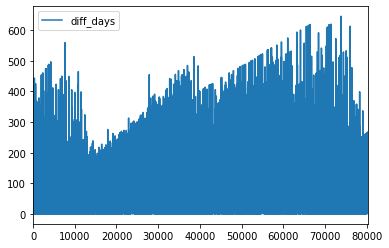

In [8]:
df.plot()

In [9]:
#work with ds and y columns
df.rename(columns={'CreatedDate':'ds', 'diff_days':'y'}, inplace =True)


C:\Users\dhall\Anaconda3\lib\site-packages\pandas\core\frame.py:4223: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [10]:
df.head()

,ds,y
0,2016-12-31,4.480556
1,2016-12-31,60.809028
2,2016-12-31,4.777778
3,2016-12-31,6.982639
4,2016-12-31,5.921528


In [11]:
# Python
m = Prophet()
m.fit(df)


INFO:numexpr.utils:NumExpr defaulting to 8 threads.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\dhall\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [12]:
# Python
future = m.make_future_dataframe(periods=730)
future.tail()

,ds
81013,2020-12-26
81014,2020-12-27
81015,2020-12-28
81016,2020-12-29
81017,2020-12-30


In [13]:
# Python
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
81013,2020-12-26,-25.610195,-163.206775,110.239807
81014,2020-12-27,-25.651503,-163.585815,110.116166
81015,2020-12-28,-21.945294,-151.261323,122.722031
81016,2020-12-29,-20.061520,-159.720738,114.575635
81017,2020-12-30,-20.899753,-163.238382,116.205237


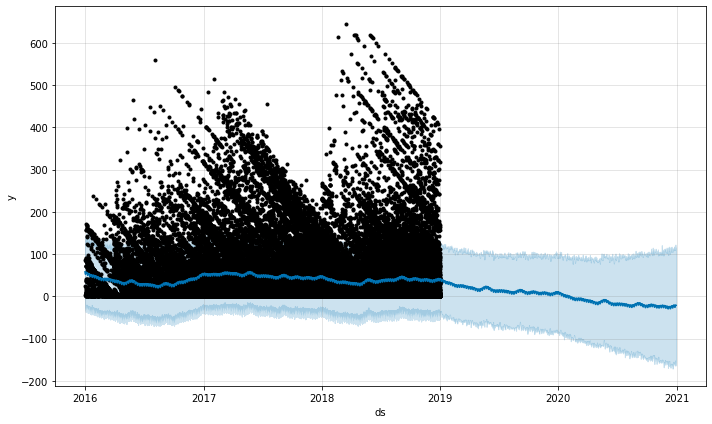

In [14]:
# Python
fig1 = m.plot(forecast)


In [15]:
Prophet.plot_components

<function fbprophet.forecaster.Prophet.plot_components(self, fcst, uncertainty=True, plot_cap=True, weekly_start=0, yearly_start=0, figsize=None)>

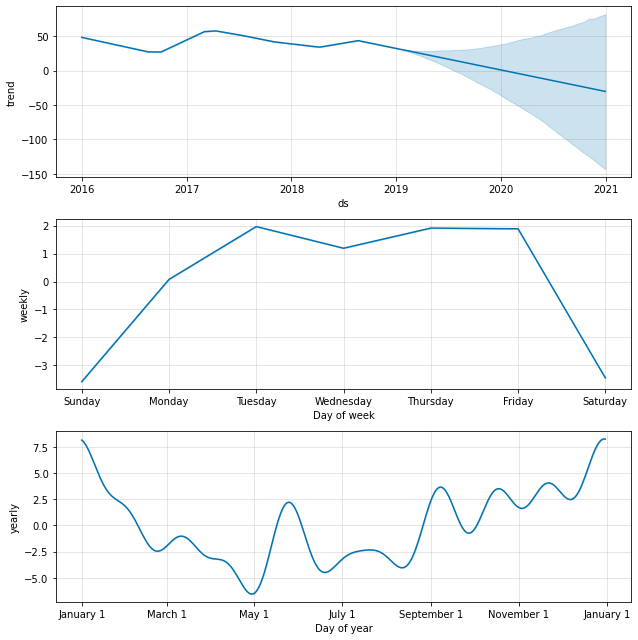

In [16]:
# Python
fig2 = m.plot_components(forecast)


In [17]:
# Python
from fbprophet.plot import plot_plotly
import plotly.offline as py
py.init_notebook_mode()

fig = plot_plotly(m, forecast)  # This returns a plotly Figure
py.iplot(fig)

#effect of holidays


In [18]:
# Python
blackFriday= pd.DataFrame({
  'holiday': 'blackFriday',
  'ds': pd.to_datetime(['11/25/2016', '11/24/2017', '11/23/2018','11/29/2019', '11/27/2020']),
  'lower_window': 0,
  'upper_window': 1,
})
christmasEve= pd.DataFrame({
  'holiday': 'christmasEve',
  'ds': pd.to_datetime(['12/24/2016', '12/24/2017','12/24/2018', '12/24/2019','12/24/2020']),
  'lower_window': 0,
  'upper_window': 1,
})
holidays = pd.concat((blackFriday, christmasEve))

In [19]:
# Python
m = Prophet(holidays=holidays)
forecast = m.fit(df).predict(future)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\dhall\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [20]:
# Python
forecast[(forecast['blackFriday'] + forecast['christmasEve']).abs() > 0][
        ['ds', 'blackFriday', 'christmasEve']][-10:]

,ds,blackFriday,christmasEve
79569,2018-12-25,0.000000,-13.142845
79570,2018-12-25,0.000000,-13.142845
80620,2019-11-29,2.626025,0.000000
80621,2019-11-30,-8.286344,0.000000
80645,2019-12-24,0.000000,0.729143
80646,2019-12-25,0.000000,-13.142845
80984,2020-11-27,2.626025,0.000000
80985,2020-11-28,-8.286344,0.000000
81011,2020-12-24,0.000000,0.729143
81012,2020-12-25,0.000000,-13.142845


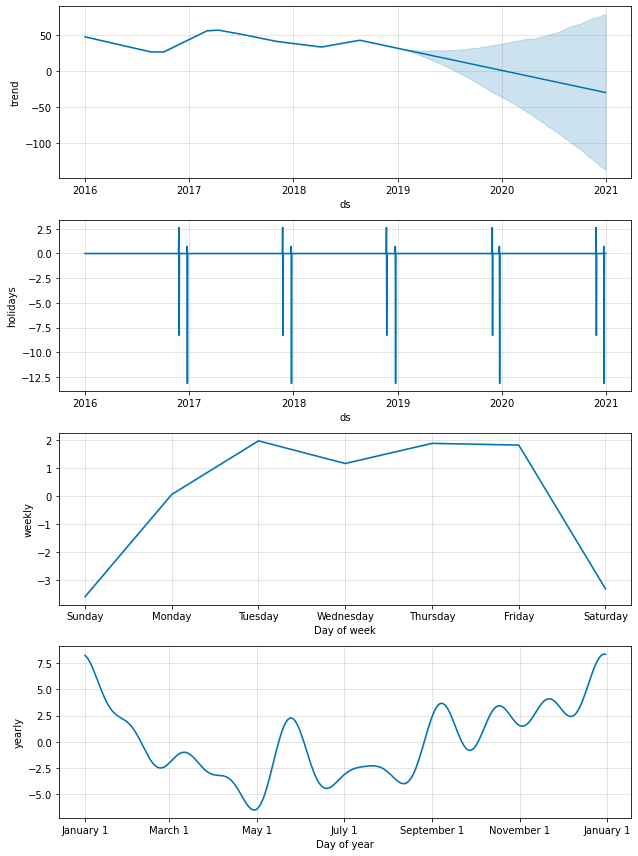

In [21]:
# Python
fig = m.plot_components(forecast)


In [22]:
m = Prophet(holidays=holidays)
m.add_country_holidays(country_name='US')
m.fit(df)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\dhall\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [23]:
# Python
m.train_holiday_names


0                     blackFriday
1                    christmasEve
2                  New Year's Day
3     Martin Luther King, Jr. Day
4           Washington's Birthday
5                    Memorial Day
6                Independence Day
7                       Labor Day
8                    Columbus Day
9                    Veterans Day
10                   Thanksgiving
11                  Christmas Day
12       Christmas Day (Observed)
13      New Year's Day (Observed)
14        Veterans Day (Observed)
dtype: object

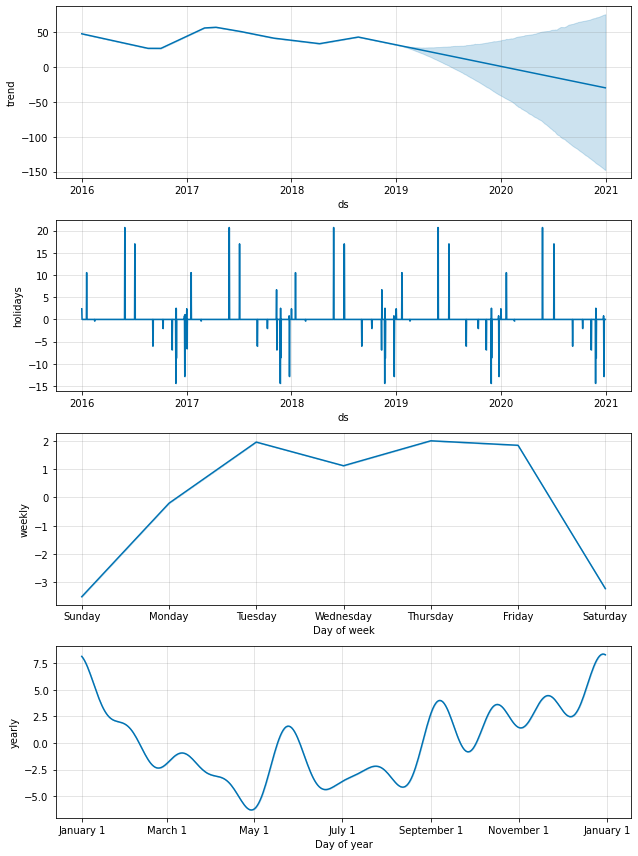

In [24]:
# Python
forecast = m.predict(future)
fig = m.plot_components(forecast)


##Fourier order of Seasonalities

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
C:\Users\dhall\Anaconda3\lib\site-packages\pystan\misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



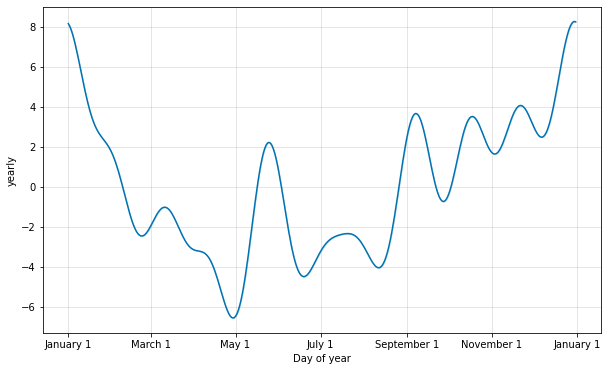

In [25]:
# Python
from fbprophet.plot import plot_yearly
m = Prophet().fit(df)
a = plot_yearly(m)

In [ ]:
#monthly seasonality

# Python
m = Prophet(weekly_seasonality=False)
m.add_seasonality(name='monthly', period=30.5, fourier_order=5)
forecast = m.fit(df).predict(future)
fig = m.plot_components(forecast)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
